In [1]:
import math
import numpy as np

import cv2
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
import plotly.graph_objects as go
%matplotlib inline

import tensorflow as tf
tf.keras.backend.clear_session()
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
tf.debugging.set_log_device_placement(True)

import logging
logger = tf.get_logger()
logger.setLevel(logging.ERROR)

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  # FATAL
logging.getLogger('tensorflow').setLevel(logging.FATAL)

Num GPUs Available:  1


In [2]:
print(tf.__version__)

2.1.0


In [3]:
def load_horses_orig(path, image_size):
    mask_path = path + 'masks/'
    image_path = path + 'images/'
    images = []
    masks = []
    test_images = []
    test_masks = []
    
    for i in range(328):
        
        orig_im = cv2.imread(image_path + 'image-{}.png'.format(i))
        orig_im= cv2.cvtColor(orig_im, cv2.COLOR_RGB2BGR)
        
        low_im = cv2.resize(orig_im, dsize=(image_size, image_size))

        orig_mask = cv2.imread(mask_path + 'mask-{}.png'.format(i))
        low_mask = cv2.resize(orig_mask, dsize=(image_size, image_size))
        low_mask = cv2.cvtColor(low_mask, cv2.COLOR_RGB2GRAY)
        bin_mask = (low_mask > 0) + 0
        
        images.append(low_im)
        masks.append(bin_mask)
    
    xtest = np.reshape(np.array(images[250:]), (-1,image_size, image_size, 3))
    ytest = np.reshape(np.array(masks[250:]), (-1, image_size, image_size, 1))
    xdata = np.reshape(np.array(images[:200]), (-1,image_size, image_size, 3))
    ydata = np.reshape(np.array(masks[:200]), (-1, image_size, image_size, 1))
    yval =  np.reshape(np.array(masks[200:250]), (-1, image_size, image_size, 1))
    xval = np.reshape(np.array(images[200:250]), (-1,image_size, image_size, 3))
    return xdata, xval, xtest, ydata, yval, ytest

In [4]:
#change the path address 
path = './horses/'
image_size = 32
xdata, xval, xtest, ydata, yval, ytest = load_horses_orig(path, image_size)

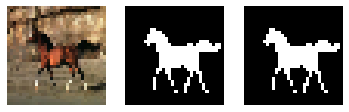

(32, 32, 3) (32, 32, 1)


In [5]:
def draw(image, mask):
    fig, (ax1,ax2) = plt.subplots(1,2) 
    ax1.axis('off')
    ax2.axis('off')
    ax1.imshow(np.reshape(image, (image_size,image_size,3)))
    ax2.imshow(np.reshape(mask, (image_size,image_size)), cmap=plt.cm.gray)
    plt.show()

def draw_all(image, real_mask, fake_mask):
    fig, (ax1,ax2,ax3) = plt.subplots(1,3)
    ax1.axis('off')
    ax2.axis('off')
    ax3.axis('off')
    ax1.imshow(image)
    ax2.imshow(real_mask, cmap=plt.cm.gray)
    ax3.imshow(fake_mask, cmap=plt.cm.gray)
    plt.show()
    
draw_all(xdata[0], ydata[0], ydata[0])
print(xdata[0].shape, ydata[0].shape)

In [6]:
# Do not change this cell
def iou(ytrue, yprediction):
    yp = yprediction
    yt = ytrue
    yp = yp > 0.5 + 0
    intersect = np.sum(np.minimum(yp, yt))
    union = np.sum(np.maximum(yp, yt))
    return np.average(intersect / (union+0.0))

In [7]:
assert iou(ydata, ydata) == 1.0

# CNN GAN

In [8]:
class Discriminator(tf.keras.Model):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.concat_layer = tf.keras.layers.Concatenate(axis=3)
        
        self.conv1 = tf.keras.layers.Conv2D(1, 3, 2, activation = tf.nn.softplus)
        self.conv2 = tf.keras.layers.Conv2D(32, 3, 2, activation = tf.nn.softplus)
        self.conv3 = tf.keras.layers.Conv2D(64, 3, 2, activation = tf.nn.softplus)
        self.conv4 = tf.keras.layers.Conv2D(128, 3, 2, activation = tf.nn.softplus)
        
        self.flatten = tf.keras.layers.Flatten()
        self.fc_score = tf.keras.layers.Dense(1)

    def call(self, x, yt, y):
        x = tf.cast(x, tf.float32)
        yt = tf.cast(yt, tf.float32)
        y = tf.cast(y, tf.float32)

        x = self.concat_layer([x, yt, y])
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.flatten(x)
        x = self.fc_score(x)
        return x

class Generator(tf.keras.Model):
    def __init__(self):
        super(Generator, self).__init__()

        self.concat_layer = tf.keras.layers.Concatenate(axis=3)
        self.conv1 = tf.keras.layers.Conv2DTranspose(128, 3, 2, activation = tf.nn.softplus, padding = 'same')
        self.conv2 = tf.keras.layers.Conv2DTranspose(64, 3, 2, activation = tf.nn.softplus, padding = 'same')
        self.conv3 = tf.keras.layers.Conv2DTranspose(32, 3, 2, activation = tf.nn.softplus, padding = 'same')
        self.conv4 = tf.keras.layers.Conv2DTranspose(1, 3, 2, activation = tf.nn.softplus, padding = 'same')
        
        self.flatten = tf.keras.layers.Flatten()
        self.fc_energy = tf.keras.layers.Dense(1)
        
    def call(self, x, z):
        x = tf.cast(x, tf.float32)
        x = self.concat_layer([x, z])
        
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.flatten(x)
        x = self.fc_energy(x)
        return x

# Unrolled Inference

In [9]:
def compute_gradient(x, y):
    y = tf.Variable(y)
    with tf.GradientTape() as t:
        t.watch(y)
        energy = gen(x, y)
    return t.gradient(energy, y)

def unrolled_inf(images, fake_label, inf_iter, inf_rate):
    yp_ind = fake_label;    y_start = yp_ind;     current_yp_ind = y_start
    
    yp_ar = []
    for i in range(inf_iter):
        gradients = compute_gradient(images, yp_ind)
        
        next_yp_ind = tf.math.add(current_yp_ind, tf.math.multiply(inf_rate, gradients))
        
        # Langevin dynamics
        temp = tf.cast(inf_rate/2, tf.float32)
        temp = temp * gradients + tf.random.normal(gradients.get_shape().as_list(), mean=0, stddev=inf_rate)
        next_yp_ind = next_yp_ind + temp
        current_yp_ind = next_yp_ind
        
        yp_ind = current_yp_ind
        yp_ar.append(yp_ind)
        
    yp = yp_ar[-1]
    yp = tf.nn.sigmoid(yp)
    return yp

def test_time_inf(images, fake_label, inf_iter, inf_rate):
    yp_ind = fake_label;    y_start = yp_ind;     current_yp_ind = y_start
    
    yp_ar = []
    for i in range(inf_iter):
        gradients = compute_gradient(images, yp_ind)
        
        next_yp_ind = tf.math.add(current_yp_ind, tf.math.multiply(inf_rate, gradients))
        
        # Langevin dynamics
        temp = tf.cast(inf_rate/2, tf.float32)
        temp = temp * gradients
        next_yp_ind = next_yp_ind + temp
        current_yp_ind = next_yp_ind
        
        yp_ind = current_yp_ind
        yp_ar.append(yp_ind)
        
    yp = yp_ar[-1]
    yp = tf.nn.sigmoid(yp)
    return yp

# Visualization

In [10]:
def plot_figure(loss, arange, brange, start, end, step, plot_name):
    axis_length = len(np.linspace(start, end, step))
    loss = loss.numpy().reshape(-1, axis_length)

    # plot the surface plot with plotly's Surface
    fig = go.Figure(data=go.Surface(z=loss,
                                    x=arange,
                                    y=brange))

    # add a countour plot
    fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                      highlightcolor="limegreen", project_z=True))

    # annotate the plot
    fig.update_layout(title=plot_name,
                      scene=dict(
                        xaxis_title='Pred. Label Axis-0',
                        yaxis_title='Pred. Label Axis-1',
                        zaxis_title=plot_name),
                      width=700, height=700)

    fig.show()
    
def generate_vectors(real_image, real_label, fake_label, start, end, step):
    arange = np.linspace(start, end, step)
    brange = np.linspace(start, end, step)

    alen = arange.shape[0]
    blen = brange.shape[0]

    r1 = np.random.uniform(0, 1, (fake_label.shape[0], image_size * image_size))
    r1[:,0] = 1 - r1[:,1]
    r2 = np.random.uniform(0, 1, (fake_label.shape[0], image_size * image_size))
    r2[:,0] = 1 - r2[:,1]
    
    y_img = np.zeros((alen*blen, fake_label.shape[0], image_size * image_size * 3))
    y_pred = np.zeros((alen*blen, fake_label.shape[0], image_size * image_size))
    y_true = np.zeros((alen*blen, fake_label.shape[0], image_size * image_size))
    for b in range(0,blen):
        for a in range(0,alen):
            k = arange[a]
            l = brange[b]
            y_pred[b*alen+a] = tf.clip_by_value(fake_label[0, :] + l*r1[0, :] + k*r2[0, :], 0.0, 1.0) # just one horse
            y_true[b*alen+a] = real_label[0]
            y_img[b*alen+a] = real_image[0]
    return arange, brange, y_img, y_pred, y_true

def plot_contour_ce(real_image, real_label, inf_iter, inf_rate, start, end, step):
    batch_size = real_label.shape[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    fake_label = test_time_inf(real_image, z, inf_iter, inf_rate)
    
    fake_label = np.array(fake_label).reshape(-1, image_size * image_size)
    real_label = np.array(real_label).reshape(-1, image_size * image_size)
    real_image = np.array(real_image).reshape(-1, image_size * image_size * 3)

    arange, brange, y_img, y_pred, y_true = generate_vectors(real_image, real_label, fake_label, start, end, step)

    # CE Loss
    loss = tf.keras.losses.binary_crossentropy(y_true, y_pred)
    plot_figure(loss, arange, brange, start, end, step, 'Cross Entropy')

    
def plot_contour_adv(real_image, real_label, inf_iter, inf_rate, start, end, step):
    batch_size = real_label.shape[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    fake_label = test_time_inf(real_image, z, inf_iter, inf_rate)
    
    fake_label = np.array(fake_label).reshape(-1, image_size * image_size)
    real_label = np.array(real_label).reshape(-1, image_size * image_size)
    real_image = np.array(real_image).reshape(-1, image_size * image_size * 3)
    
    # Adv loss
    arange, brange, y_img, y_pred, y_true = generate_vectors(real_image, real_label, fake_label, start, end, step)
    
    real_image = y_img.reshape(-1, image_size, image_size, 3)
    real_label = y_true.reshape(-1, image_size, image_size, 1)
    fake_label = y_pred.reshape(-1, image_size, image_size, 1)
    
    real_image = tf.cast(real_image, tf.float32)
    real_label = tf.cast(real_label, tf.float32)
    fake_label = tf.cast(fake_label, tf.float32)
    
    # disc signals
    fake_score = dis(real_image, real_label, fake_label)

    # adv loss
    energy_value = fake_score
    alpha = 0.01
    loss = alpha * reward(fake_label, real_label) - energy_value
    plot_figure(loss, arange, brange, start, end, step, 'Adversarial loss')
    
    
def plot_hist(fake, real):
    fake = np.array(fake).reshape(-1, 1)
    real = np.array(real).reshape(-1, 1)
    bins = len(fake)
    plt.figure(figsize=(15,5))
    plt.hist(fake, bins, alpha=0.5, color='blue', label='Fake')
    plt.hist(real, bins, alpha=0.5, color='orange', label='Real')
    plt.legend(loc='upper right')
    plt.show()
    
def calc_iou(images, labels, inf_iter, inf_rate):
    batch_size = labels.shape[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    fake_label = test_time_inf(images, z, inf_iter, inf_rate)
    return iou(labels, fake_label)

def draw_test(images, labels, inf_iter, inf_rate, name):
    batch_size = labels.shape[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    fake_label = test_time_inf(images, z, inf_iter, inf_rate)
    iou_score = iou(labels, fake_label)
    print('\n' + name + ' iou_score %:', round(iou_score*100, 2))
    
    for i in range(10):
        draw_all(images[i], labels[i], fake_label[i])
        
def plot_iou(epoch, train_iou, val_iou, test_iou):
    plt.plot(np.arange(epoch+1), np.array(train_iou), label = "train")
    plt.plot(np.arange(epoch+1), np.array(val_iou), label = "test")
    plt.plot(np.arange(epoch+1), np.array(test_iou), label = "valid")
    plt.xlabel('Epoch')
    plt.ylabel('IOU Score')
    plt.legend()
    plt.show()

# Training Functions

In [11]:
def train_step_gen(real_image, real_label, inf_iter, inf_rate, pt_loss, alpha):
    batch_size = real_image.get_shape().as_list()[0]
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    real_label = tf.cast(real_label, dtype=tf.float32)
    with tf.GradientTape() as tape:
        fake_label = unrolled_inf(real_image, z, inf_iter, inf_rate)
        fake_score = dis(real_image, real_label, fake_label)
        loss = tf.reduce_mean(fake_score) + (pt_loss * alpha)
    gradients = tape.gradient(loss, gen.trainable_variables)
    gen_opt.apply_gradients(zip(gradients, gen.trainable_variables))
    gen_loss(loss)
    
def reward(yprediction, ytrue):
    intersect = tf.math.reduce_sum(tf.math.minimum(yprediction, ytrue))
    union = tf.math.reduce_sum(tf.math.maximum(yprediction, ytrue))
    return tf.math.reduce_mean(tf.math.divide(intersect, union))

def train_step_dis(real_image, real_label, inf_iter, inf_rate):
    batch_size = real_image.get_shape().as_list()[0]
    real_label = tf.cast(real_label, dtype=tf.float32)
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    
    with tf.GradientTape() as tape:
        fake_label = unrolled_inf(real_image, z, inf_iter, inf_rate)
        real_score = dis(real_image, real_label, real_label)
        fake_score = dis(real_image, real_label, fake_label)
        
        # adv loss
        energy_value = tf.reduce_mean(fake_score)
        alpha = 0.01
        loss = tf.math.pow(tf.norm(alpha * reward(fake_label, real_label) - energy_value), 2)
    
    gradients = tape.gradient(loss, dis.trainable_variables)
    dis_opt.apply_gradients(zip(gradients, dis.trainable_variables))
    
    dis_loss(loss)
    adv_loss(loss)
    return fake_score, real_score
    
def pretrain_gen(real_image, real_label, inf_iter, inf_rate):
    batch_size = real_image.get_shape().as_list()[0]
    real_label = tf.cast(real_label, dtype=tf.float32)
    z = tf.random.uniform([batch_size, image_size, image_size, 1], 0.0, 1.0)
    with tf.GradientTape() as tape:
        fake_label = unrolled_inf(real_image, z, inf_iter, inf_rate)
        loss = tf.reduce_mean(tf.keras.losses.binary_crossentropy(real_label, fake_label))
    gradients = tape.gradient(loss, gen.trainable_variables)
    gen_opt_pt.apply_gradients(zip(gradients, gen.trainable_variables))
    gen_pretrain_loss(loss)
    return loss

def train(data, n_epoch, n_update_dis, inf_iter, inf_rate, pt_gen, alpha):
    train_iou = []; val_iou = []; test_iou = [];
    for epoch in range(n_epoch):
        print('\nepoch:', epoch)
        
        if epoch == 0:
            pt_loss = 0
        
        fake_store = [];   real_store = [];
        for images, labels in train_dataset:
            
            # train gen
            if epoch > 0:
                if pt_gen:
                    pt_loss = pretrain_gen(images, labels, inf_iter, inf_rate)
                train_step_gen(images, labels, inf_iter, inf_rate, pt_loss, alpha)
            
            # train disc
            for i in range(n_update_dis):
                fake_sc, real_sc = train_step_dis(images, labels, inf_iter, inf_rate)
            
            fake_store.append(fake_sc.numpy())
            real_store.append(real_sc.numpy())
            
        # store iou progression
        train_iou.append(calc_iou(xdata, ydata, inf_iter, inf_rate))
        val_iou.append(calc_iou(xtest, ytest, inf_iter, inf_rate))
        test_iou.append(calc_iou(xval, yval, inf_iter, inf_rate))
        
        if epoch % 20 == 0:
            plot_hist(fake_store, real_store)
            
            start, end, step = 0.0, 20.0, 10
            plot_contour_ce(xtest, ytest, inf_iter, inf_rate, start, end, step)
            
            start, end, step = -200.0, 100.0, 10
            plot_contour_adv(xtest, ytest, inf_iter, inf_rate, start, end, step)

            draw_test(xdata, ydata, inf_iter, inf_rate, 'train')
            draw_test(xtest, ytest, inf_iter, inf_rate, 'test')
            draw_test(xval, yval, inf_iter, inf_rate, 'valid')
            
            plot_iou(epoch, train_iou, val_iou, test_iou)
                
        template = 'PT Gen Loss: {}, Gen Loss: {}, Dis Loss: {}, Adv Loss: {}'
        print (template.format(gen_pretrain_loss.result(), gen_loss.result(), dis_loss.result(), adv_loss.result()))
        dis_loss.reset_states()
        adv_loss.reset_states()
        gen_loss.reset_states()
        gen_pretrain_loss.reset_states()

# Deploy Network

Executing op TensorSliceDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousRandomSeedGenerator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ShuffleDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op BatchDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarIsInitializedOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op LogicalNot in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Assert in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0

epoch: 0
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op AnonymousIteratorV2 in device /job:localhost/replica:0

Executing op Cast in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DivNoNan in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DestroyResourceOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op DeleteIterator in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Greater in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0


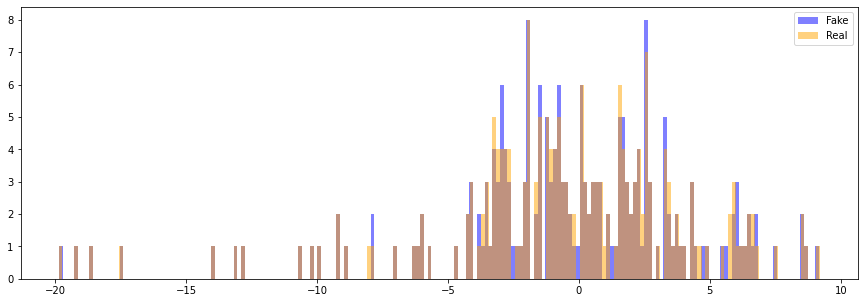

Executing op Minimum in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Maximum in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AddV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Log in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Neg in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mean in device /job:localhost/replica:0/task:0/device:GPU:0


Executing op Cast in device /job:localhost/replica:0/task:0/device:GPU:0



train iou_score %: 21.36
Executing op StridedSlice in device /job:localhost/replica:0/task:0/device:GPU:0


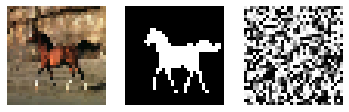

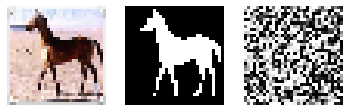

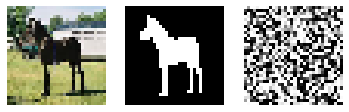

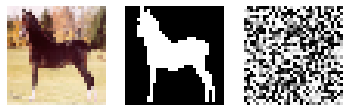

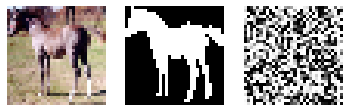

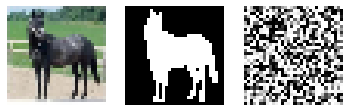

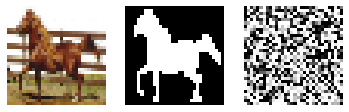

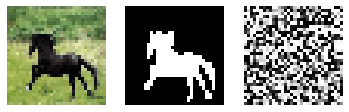

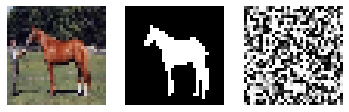

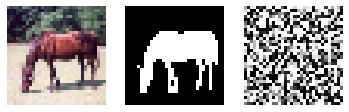


test iou_score %: 23.7


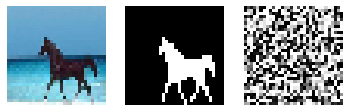

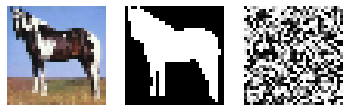

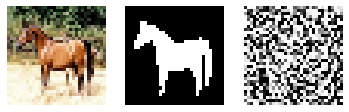

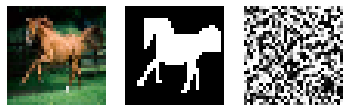

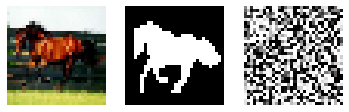

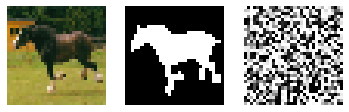

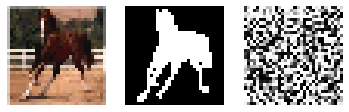

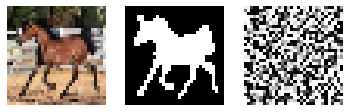

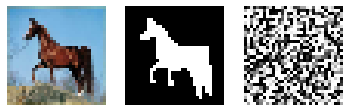

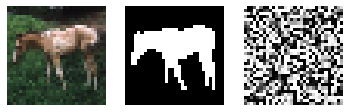


valid iou_score %: 22.94


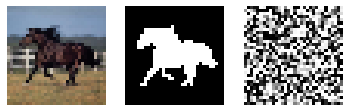

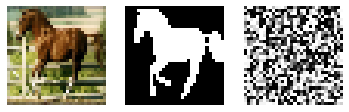

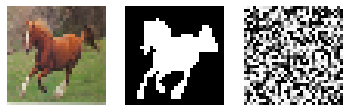

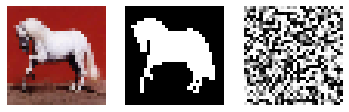

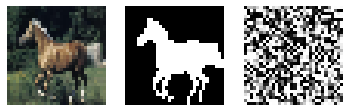

...

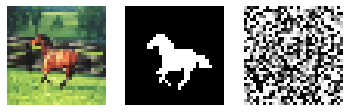

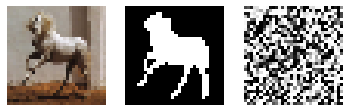

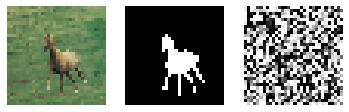

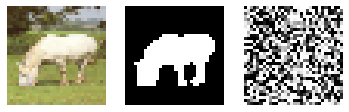

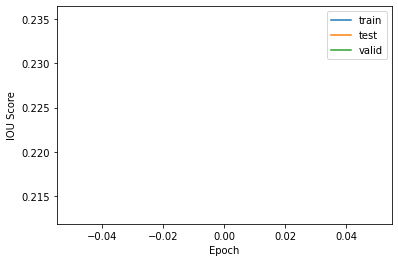

PT Gen Loss: 0.0, Gen Loss: 0.0, Dis Loss: 18.70261001586914, Adv Loss: 18.70261001586914

epoch: 1
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Log in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op BroadcastTo in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Reciprocal in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ZerosLike in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AddN in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
PT Gen Loss: 1.5263030529022217, Gen Loss: -0.35414761304855347, Dis Loss: 0.8721152544021606, Adv Loss: 0.8721152544021606

epoch: 2
Executing op OptimizeDataset in device /job:localhost/repli

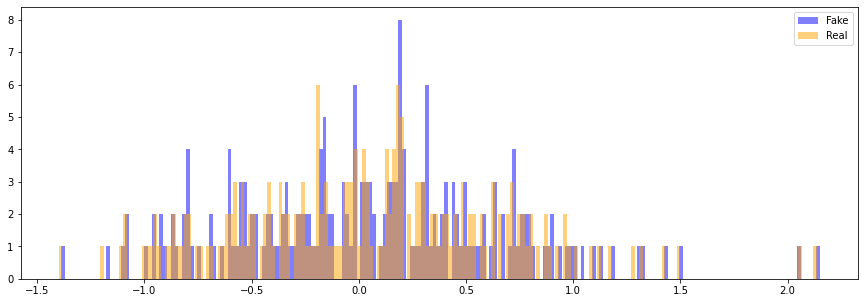


train iou_score %: 63.81


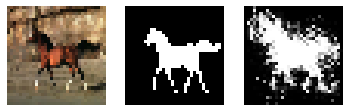

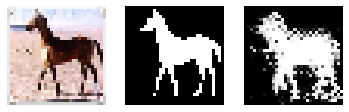

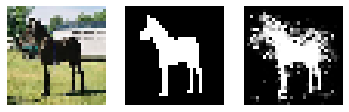

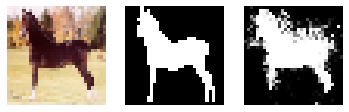

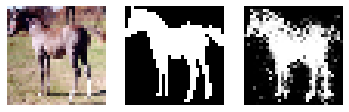

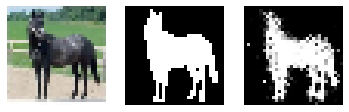

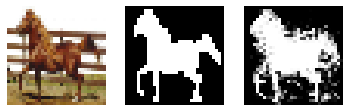

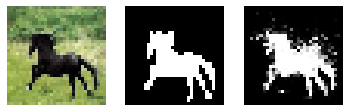

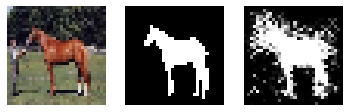

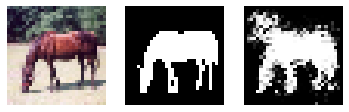


test iou_score %: 63.04


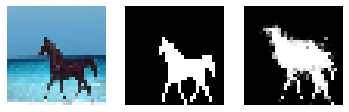

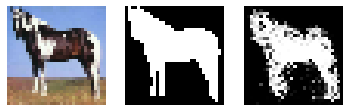

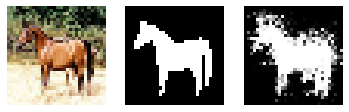

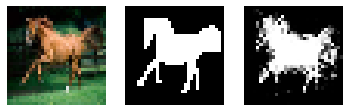

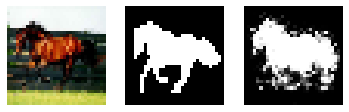

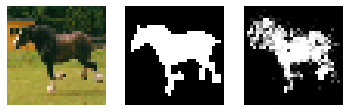

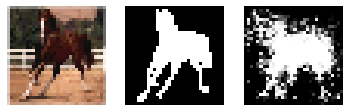

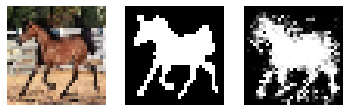

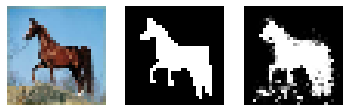

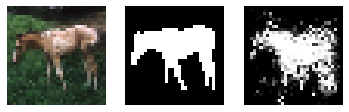


valid iou_score %: 59.24


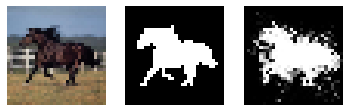

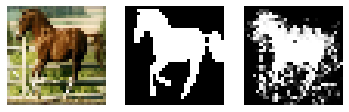

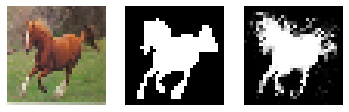

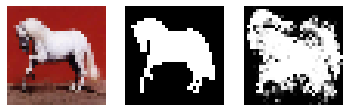

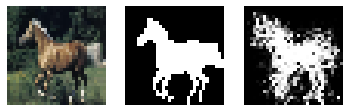

...

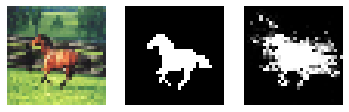

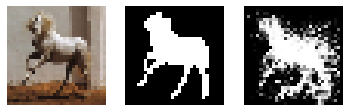

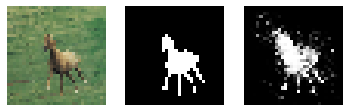

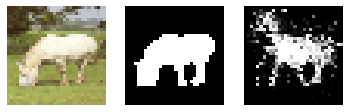

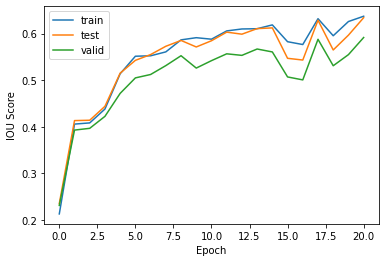

PT Gen Loss: 0.3691031336784363, Gen Loss: -0.05031769350171089, Dis Loss: 0.05157718062400818, Adv Loss: 0.05157718062400818

epoch: 21
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.3862460255622864, Gen Loss: 0.04061560705304146, Dis Loss: 0.07379291951656342, Adv Loss: 0.07379291951656342

epoch: 22
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.361807644367218, Gen Loss: 0.019562672823667526, Dis Loss: 0.04134936258196831, Adv Loss: 0.04134936258196831

epoch: 23
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.3556711673736572, Gen Loss: 0.002039118902757764, Dis Loss: 0.05669184401631355, 

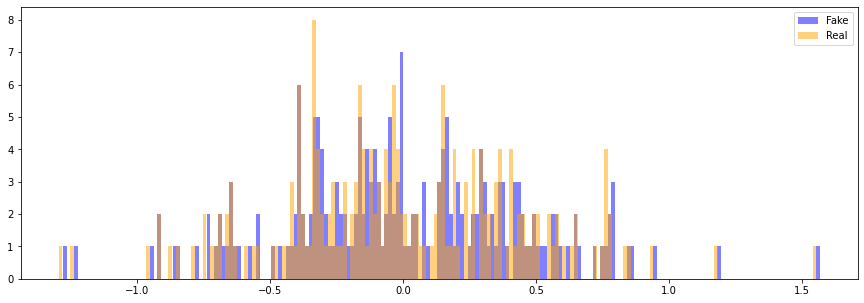


train iou_score %: 65.22


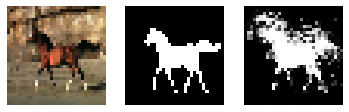

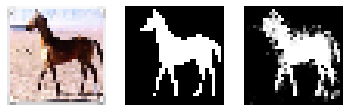

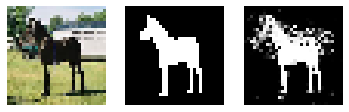

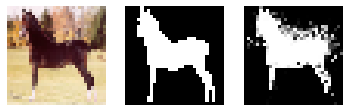

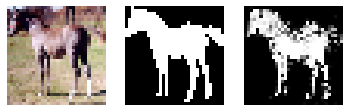

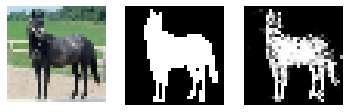

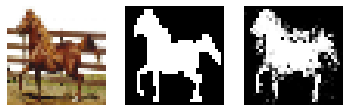

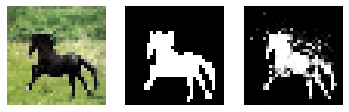

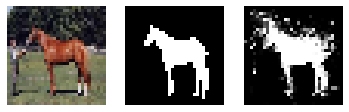

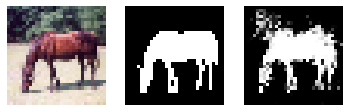


test iou_score %: 60.22


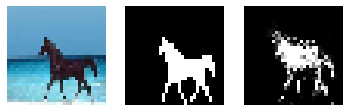

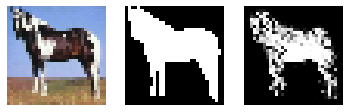

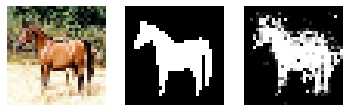

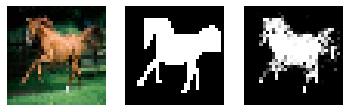

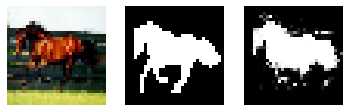

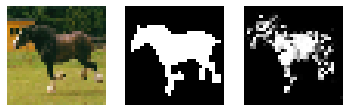

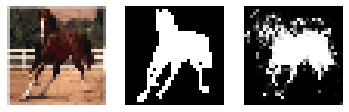

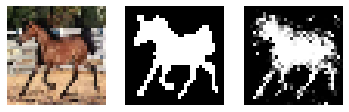

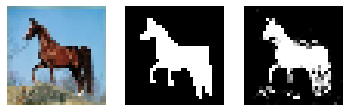

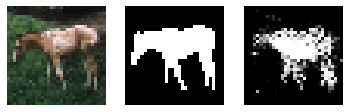


valid iou_score %: 55.96


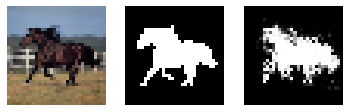

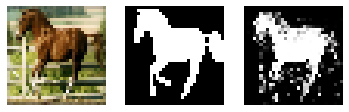

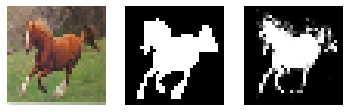

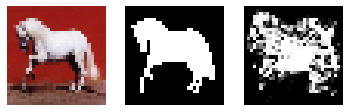

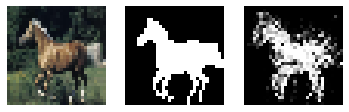

...

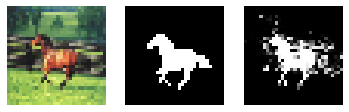

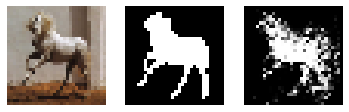

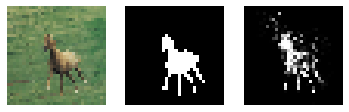

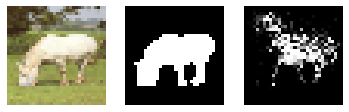

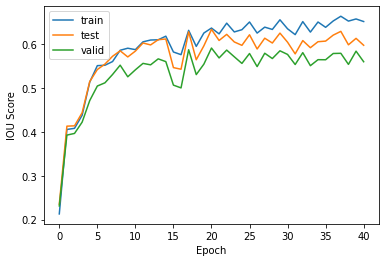

PT Gen Loss: 0.3175220191478729, Gen Loss: 0.007048425730317831, Dis Loss: 0.05051900073885918, Adv Loss: 0.05051900073885918

epoch: 41
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.3127426505088806, Gen Loss: -0.01662033423781395, Dis Loss: 0.011976695619523525, Adv Loss: 0.011976695619523525

epoch: 42
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.31413733959198, Gen Loss: 0.0029817079193890095, Dis Loss: 0.010624486953020096, Adv Loss: 0.010624486953020096

epoch: 43
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.3119080066680908, Gen Loss: 0.02267778106033802, Dis Loss: 0.031364385038614

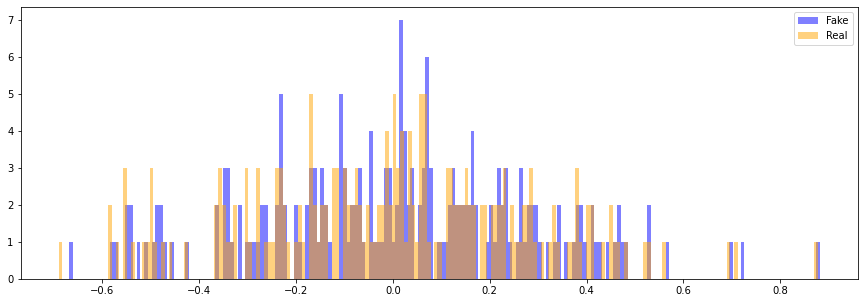


train iou_score %: 71.47


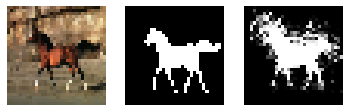

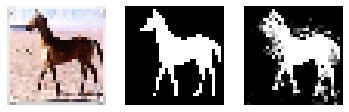

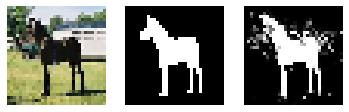

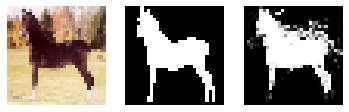

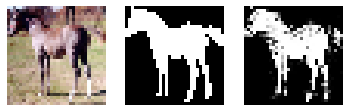

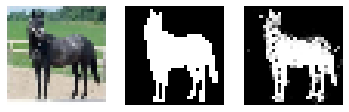

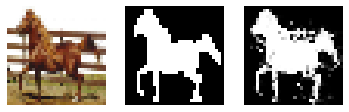

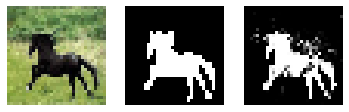

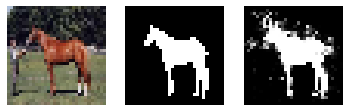

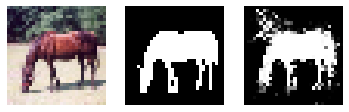


test iou_score %: 63.39


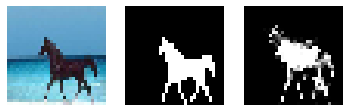

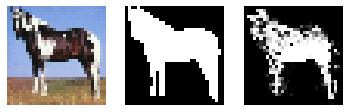

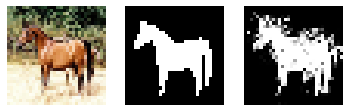

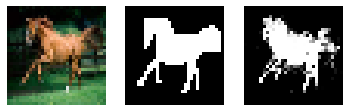

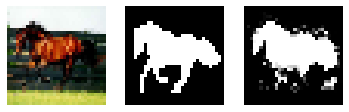

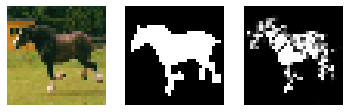

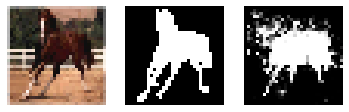

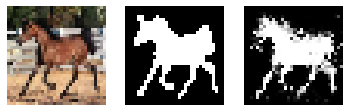

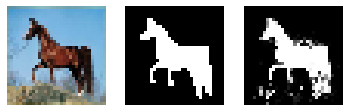

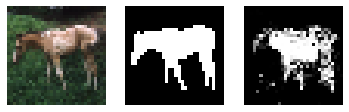


valid iou_score %: 59.38


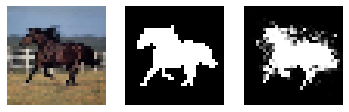

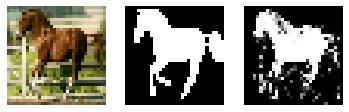

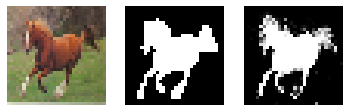

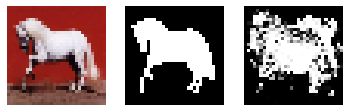

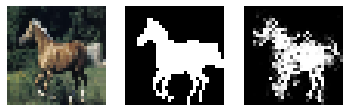

...

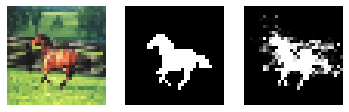

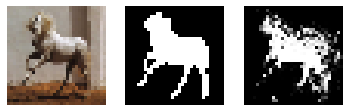

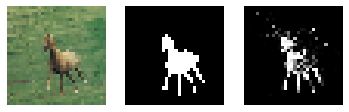

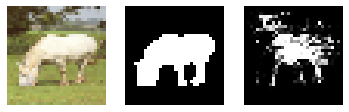

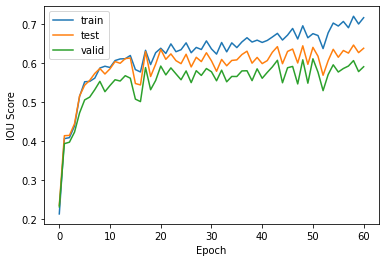

PT Gen Loss: 0.2585541009902954, Gen Loss: -0.00211007590405643, Dis Loss: 0.014644056558609009, Adv Loss: 0.014644056558609009

epoch: 61
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.2654099464416504, Gen Loss: -0.005352933891117573, Dis Loss: 0.012160228565335274, Adv Loss: 0.012160228565335274

epoch: 62
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.2664584219455719, Gen Loss: -0.015614424832165241, Dis Loss: 0.011033555492758751, Adv Loss: 0.011033555492758751

epoch: 63
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.24949100613594055, Gen Loss: 0.02487773448228836, Dis Loss: 0.022653695

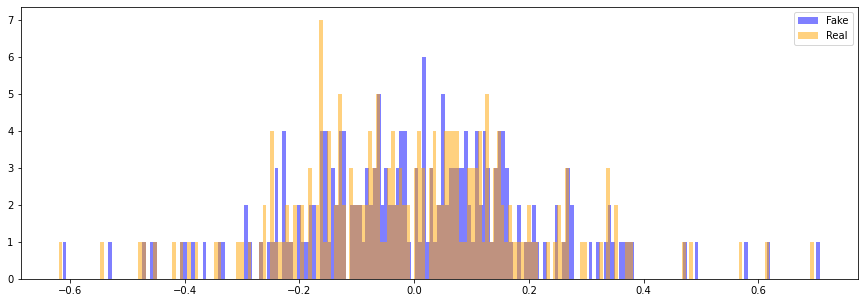


train iou_score %: 76.31


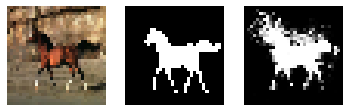

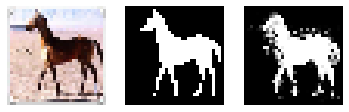

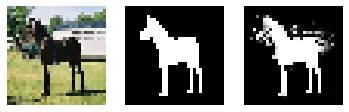

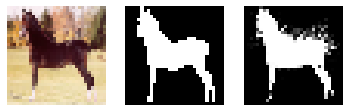

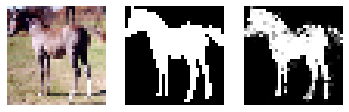

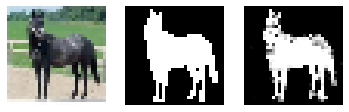

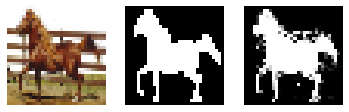

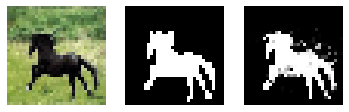

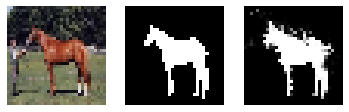

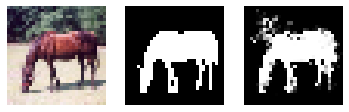


test iou_score %: 65.15


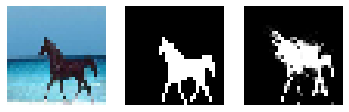

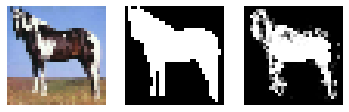

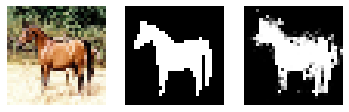

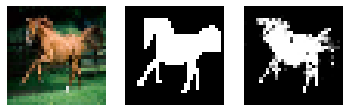

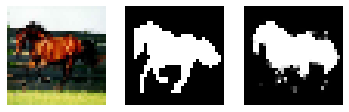

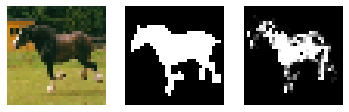

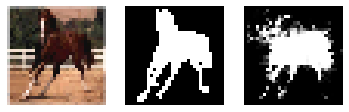

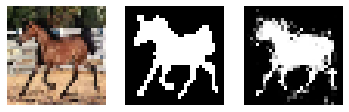

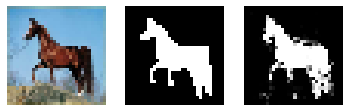

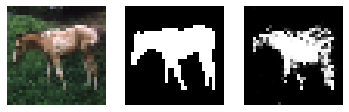


valid iou_score %: 61.02


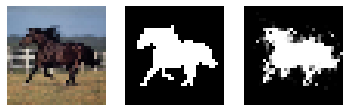

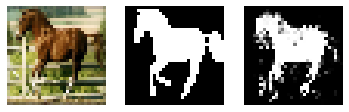

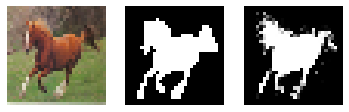

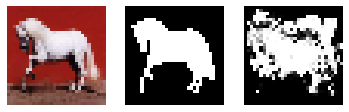

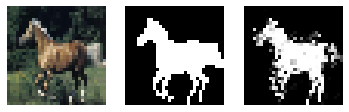

...

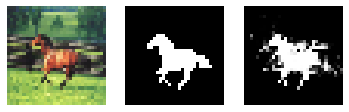

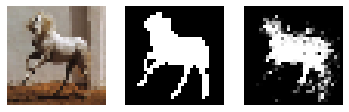

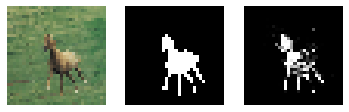

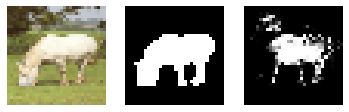

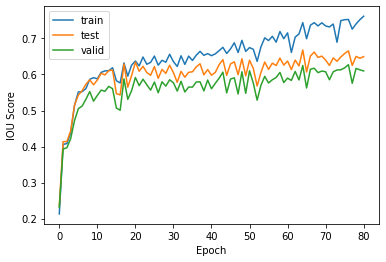

PT Gen Loss: 0.216034933924675, Gen Loss: -0.001571856439113617, Dis Loss: 0.004994160030037165, Adv Loss: 0.004994160030037165

epoch: 81
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.2038939893245697, Gen Loss: -0.024791672825813293, Dis Loss: 0.007079922594130039, Adv Loss: 0.007079922594130039

epoch: 82
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.19431541860103607, Gen Loss: -0.0017896268982440233, Dis Loss: 0.004238487686961889, Adv Loss: 0.004238487686961889

epoch: 83
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.19501051306724548, Gen Loss: 0.009255072101950645, Dis Loss: 0.007112

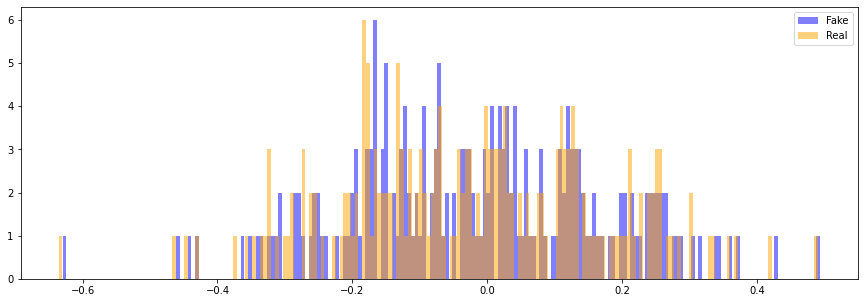


train iou_score %: 81.72


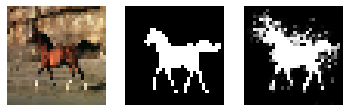

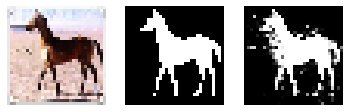

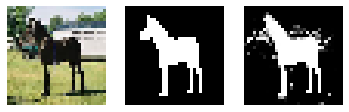

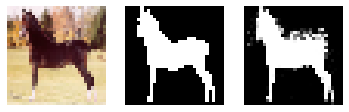

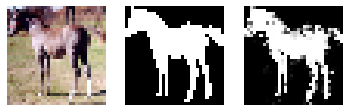

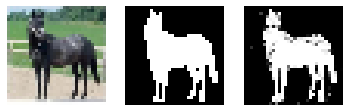

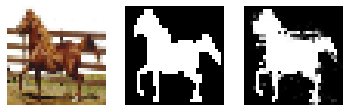

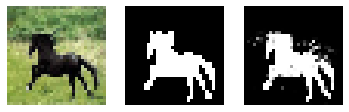

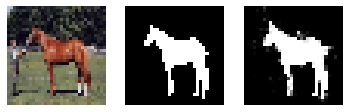

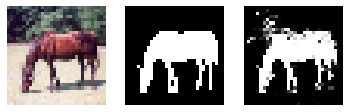


test iou_score %: 65.88


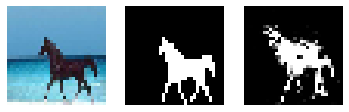

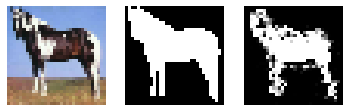

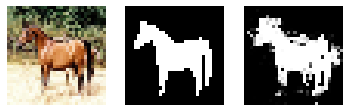

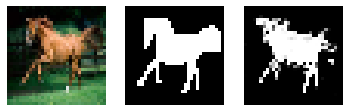

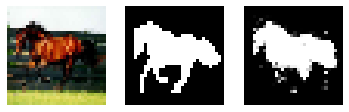

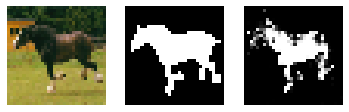

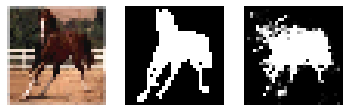

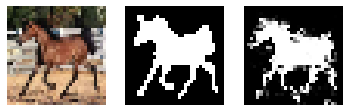

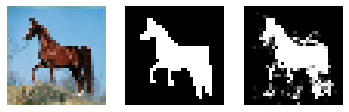

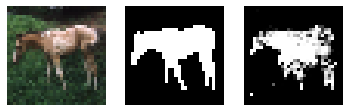


valid iou_score %: 62.79


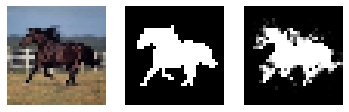

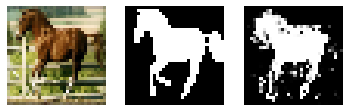

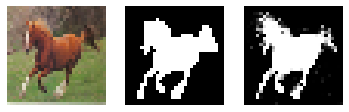

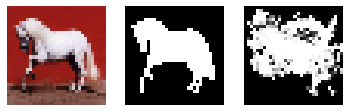

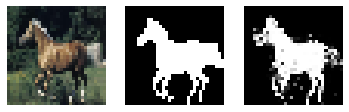

...

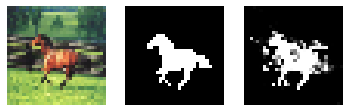

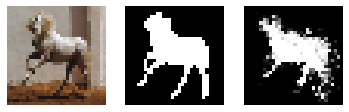

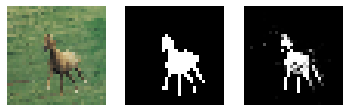

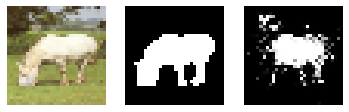

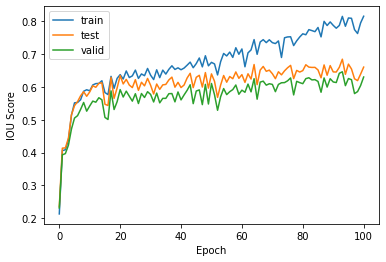

PT Gen Loss: 0.16580581665039062, Gen Loss: 0.018851393833756447, Dis Loss: 0.005580405239015818, Adv Loss: 0.005580405239015818

epoch: 101
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.15803582966327667, Gen Loss: -0.017486702650785446, Dis Loss: 0.006770014762878418, Adv Loss: 0.006770014762878418

epoch: 102
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.15281490981578827, Gen Loss: -0.014891845174133778, Dis Loss: 0.004408384673297405, Adv Loss: 0.004408384673297405

epoch: 103
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.1582542359828949, Gen Loss: 0.010134096257388592, Dis Loss: 0.006

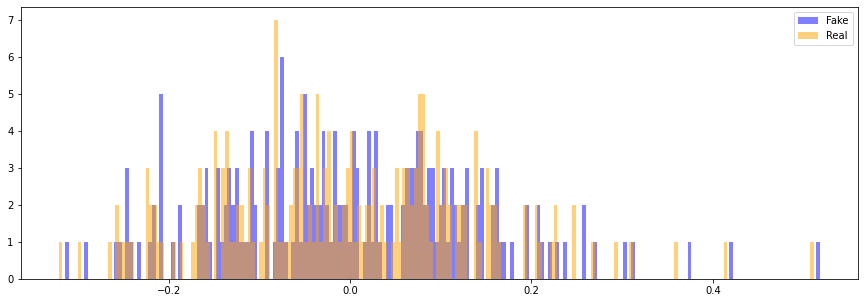


train iou_score %: 85.56


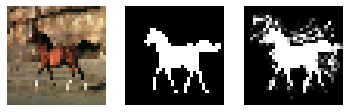

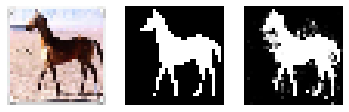

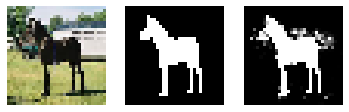

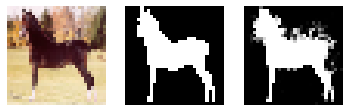

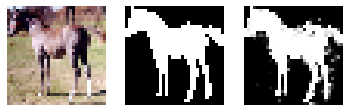

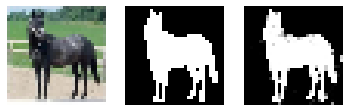

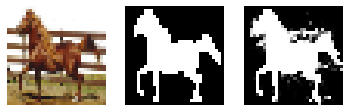

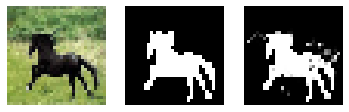

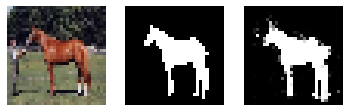

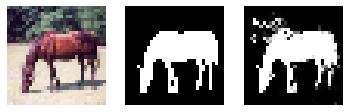


test iou_score %: 67.45


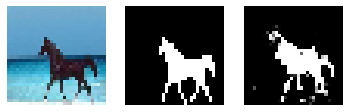

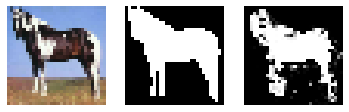

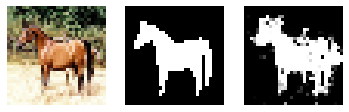

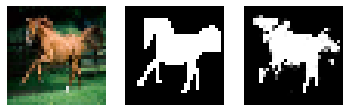

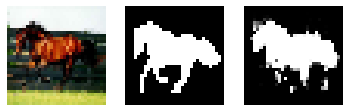

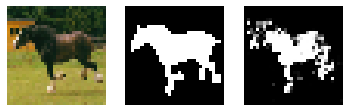

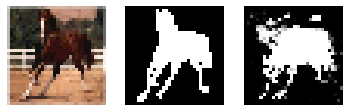

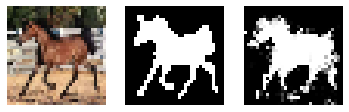

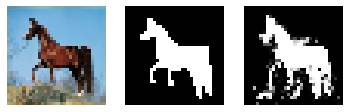

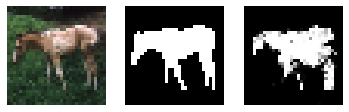


valid iou_score %: 64.29


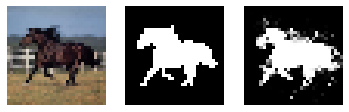

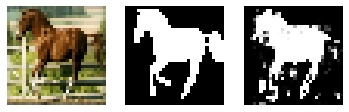

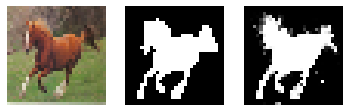

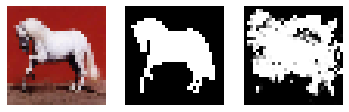

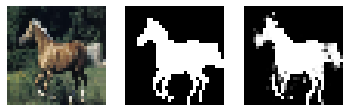

...

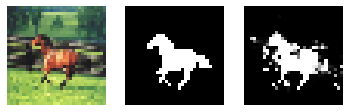

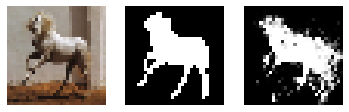

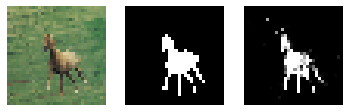

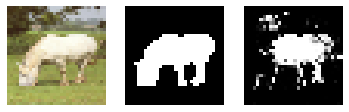

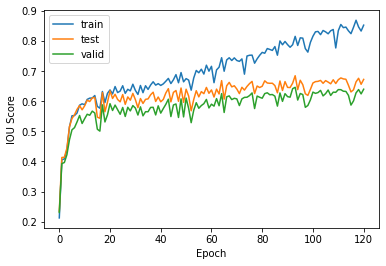

PT Gen Loss: 0.12839773297309875, Gen Loss: 0.003414275823161006, Dis Loss: 0.0024577805306762457, Adv Loss: 0.0024577805306762457

epoch: 121
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.127131387591362, Gen Loss: -0.016698049381375313, Dis Loss: 0.0032277479767799377, Adv Loss: 0.0032277479767799377

epoch: 122
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.1325940191745758, Gen Loss: -0.0026516811922192574, Dis Loss: 0.005081960000097752, Adv Loss: 0.005081960000097752

epoch: 123
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.11921222507953644, Gen Loss: -0.0016961622750386596, Dis Loss: 

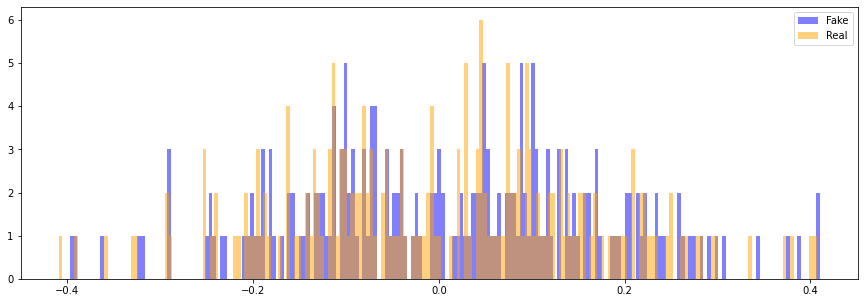


train iou_score %: 85.77


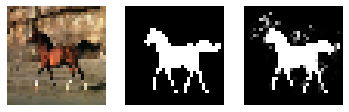

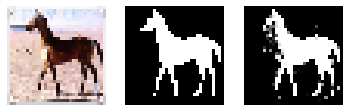

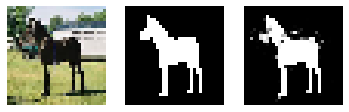

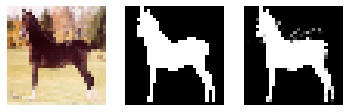

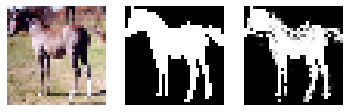

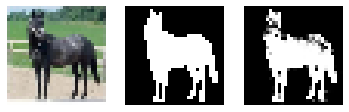

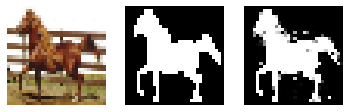

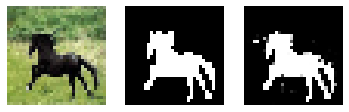

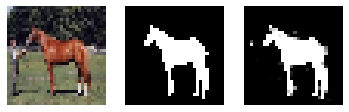

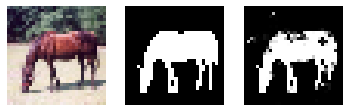


test iou_score %: 62.63


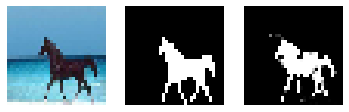

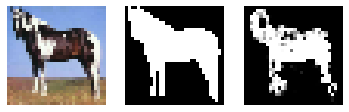

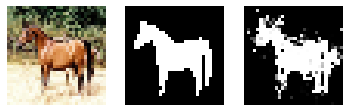

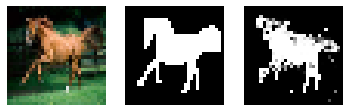

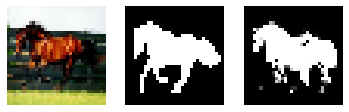

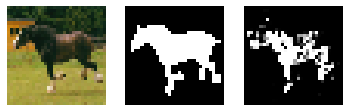

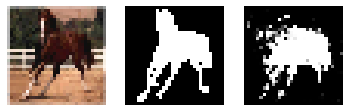

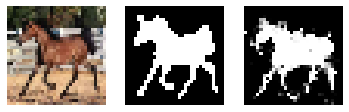

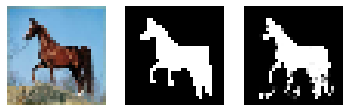

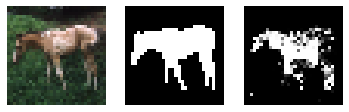


valid iou_score %: 58.38


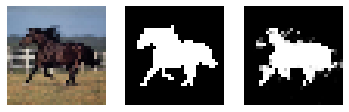

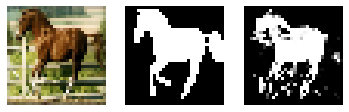

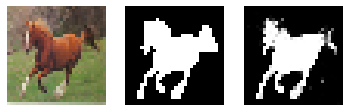

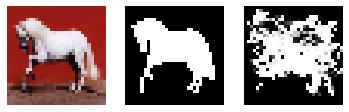

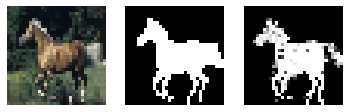

...

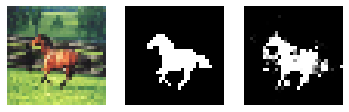

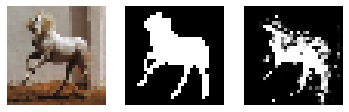

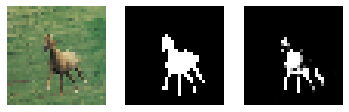

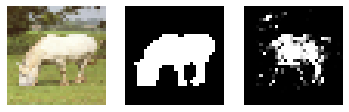

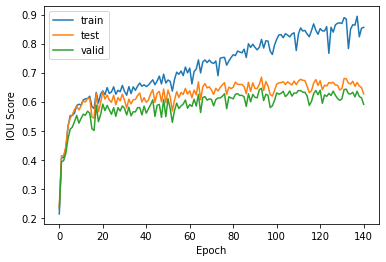

PT Gen Loss: 0.10853792726993561, Gen Loss: -0.008142543956637383, Dis Loss: 0.00548185221850872, Adv Loss: 0.00548185221850872

epoch: 141
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.1278771013021469, Gen Loss: -0.011269399896264076, Dis Loss: 0.0034926447551697493, Adv Loss: 0.0034926447551697493

epoch: 142
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.10813786089420319, Gen Loss: 0.008913879282772541, Dis Loss: 0.0038310312665998936, Adv Loss: 0.0038310312665998936

epoch: 143
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.09525217115879059, Gen Loss: -0.014863274991512299, Dis Loss: 0.

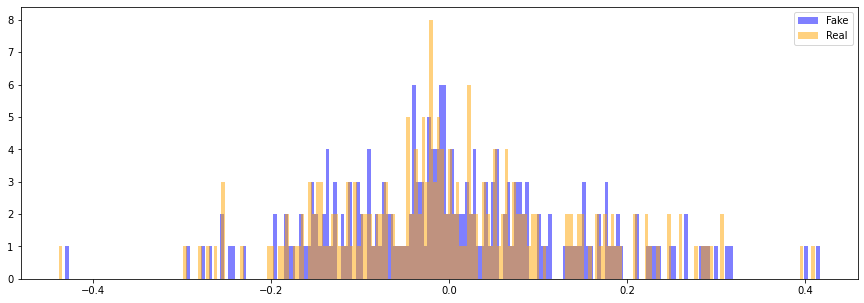


train iou_score %: 92.07


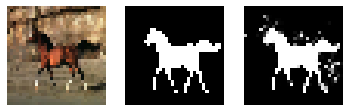

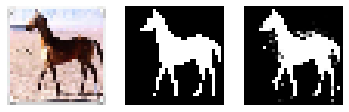

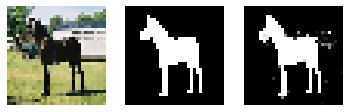

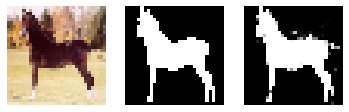

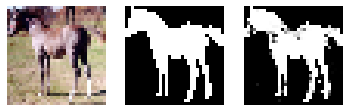

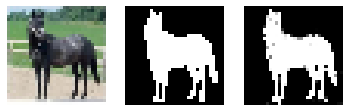

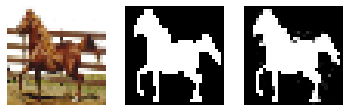

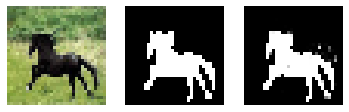

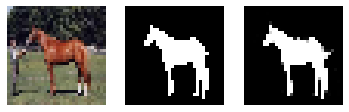

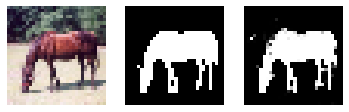


test iou_score %: 66.38


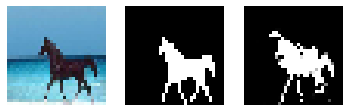

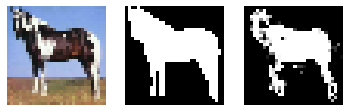

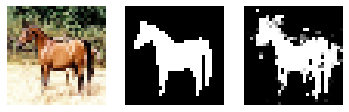

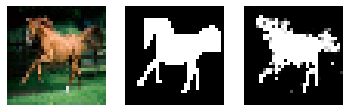

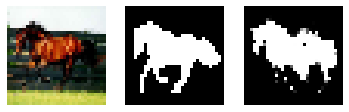

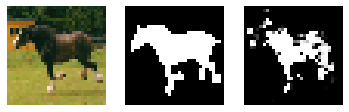

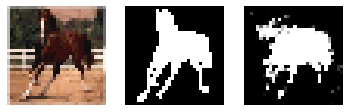

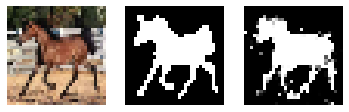

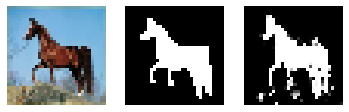

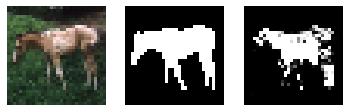


valid iou_score %: 62.99


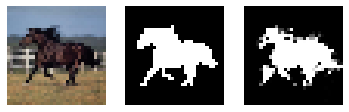

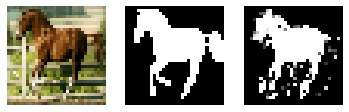

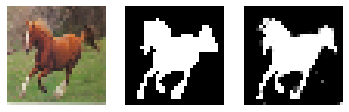

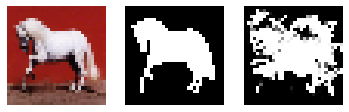

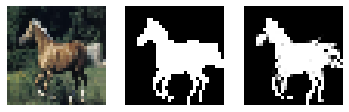

...

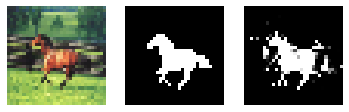

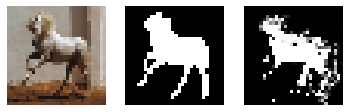

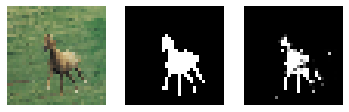

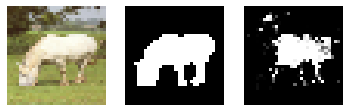

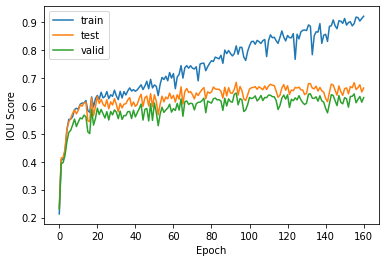

PT Gen Loss: 0.07189395278692245, Gen Loss: -0.004662451334297657, Dis Loss: 0.004660384263843298, Adv Loss: 0.004660384263843298

epoch: 161
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.0799616351723671, Gen Loss: -0.004524364601820707, Dis Loss: 0.002017409075051546, Adv Loss: 0.002017409075051546

epoch: 162
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.10315461456775665, Gen Loss: -0.006968759931623936, Dis Loss: 0.002846106421202421, Adv Loss: 0.002846106421202421

epoch: 163
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.07281181961297989, Gen Loss: -0.01750742644071579, Dis Loss: 0.00

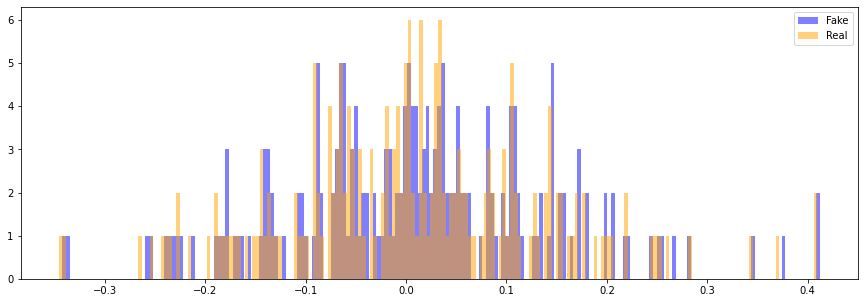


train iou_score %: 94.25


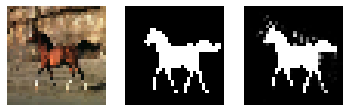

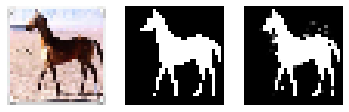

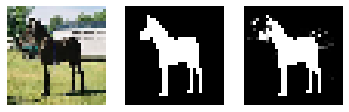

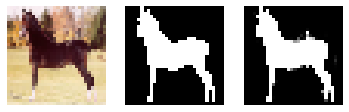

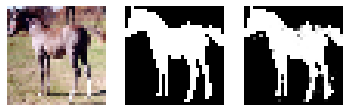

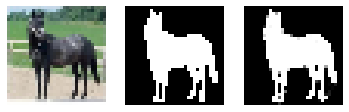

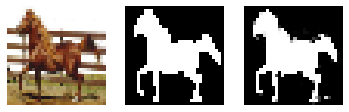

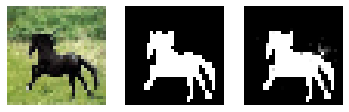

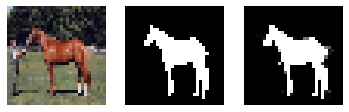

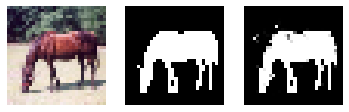


test iou_score %: 67.72


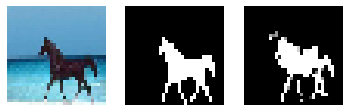

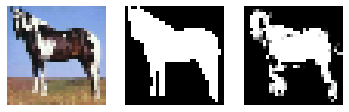

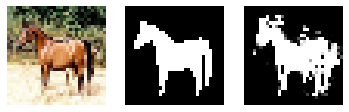

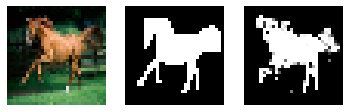

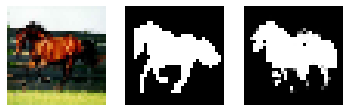

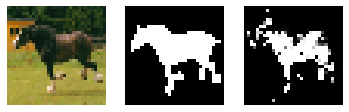

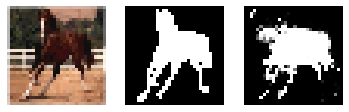

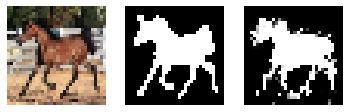

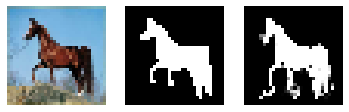

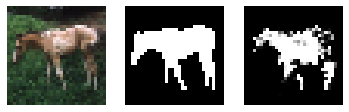


valid iou_score %: 63.63


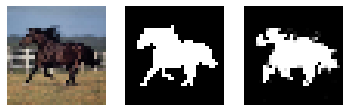

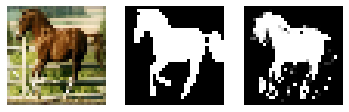

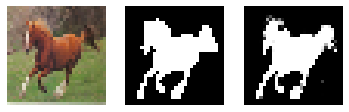

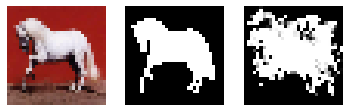

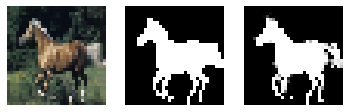

...

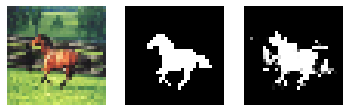

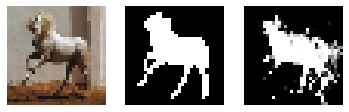

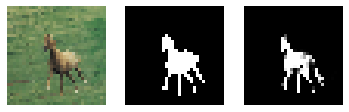

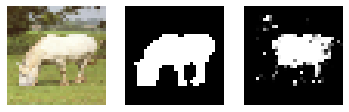

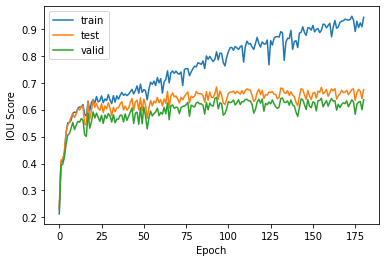

PT Gen Loss: 0.06433798372745514, Gen Loss: -0.00839150883257389, Dis Loss: 0.0037586577236652374, Adv Loss: 0.0037586577236652374

epoch: 181
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.050756633281707764, Gen Loss: -0.003949267324060202, Dis Loss: 0.0030603022314608097, Adv Loss: 0.0030603022314608097

epoch: 182
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.04905258119106293, Gen Loss: -0.008523103781044483, Dis Loss: 0.0027693896554410458, Adv Loss: 0.0027693896554410458

epoch: 183
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.07929733395576477, Gen Loss: -0.005572834052145481, Dis Lo

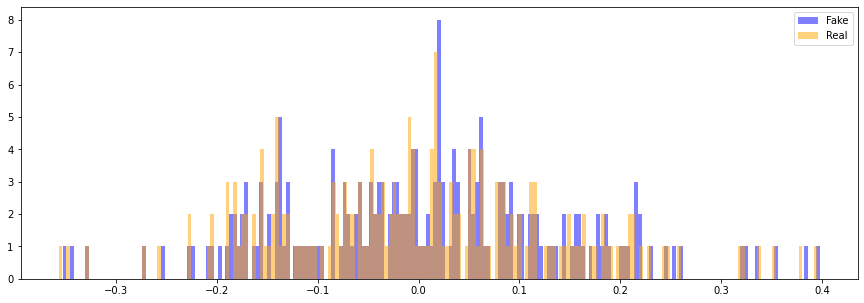


train iou_score %: 93.95


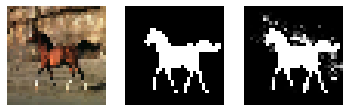

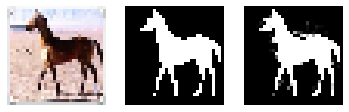

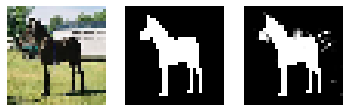

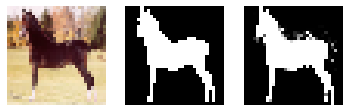

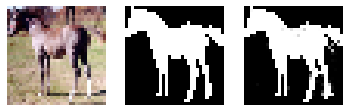

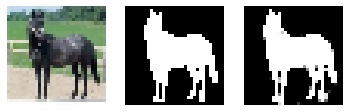

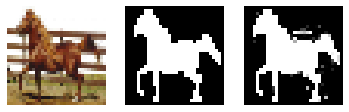

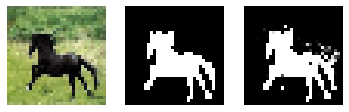

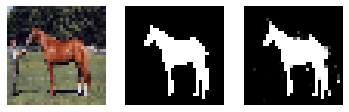

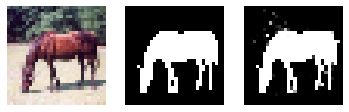


test iou_score %: 67.84


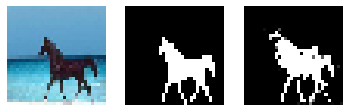

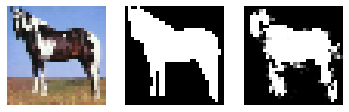

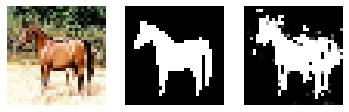

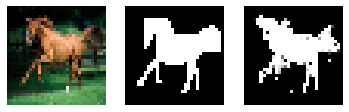

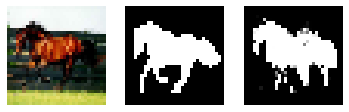

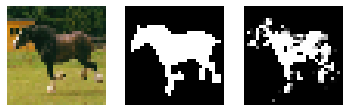

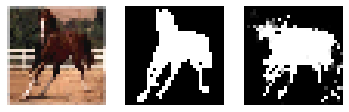

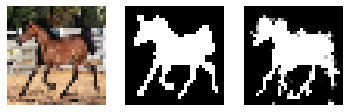

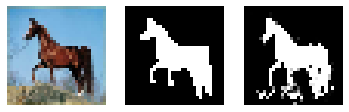

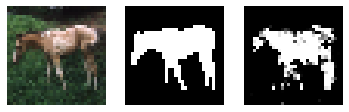


valid iou_score %: 63.78


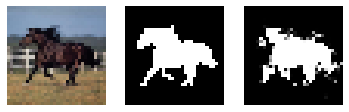

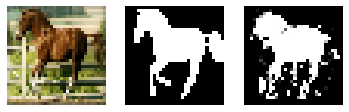

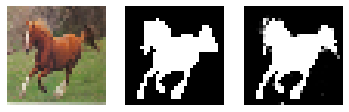

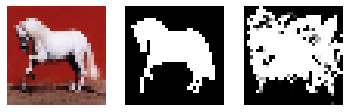

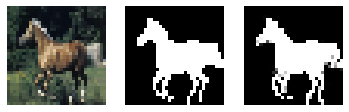

...

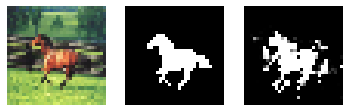

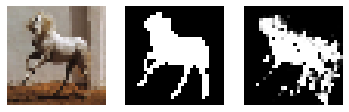

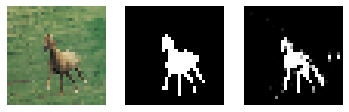

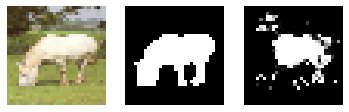

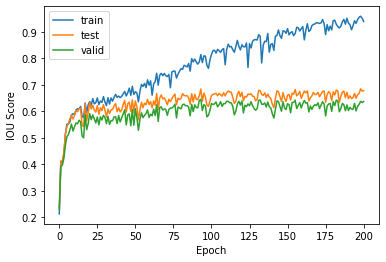

PT Gen Loss: 0.04170305281877518, Gen Loss: -0.005360574461519718, Dis Loss: 0.003799036145210266, Adv Loss: 0.003799036145210266

epoch: 201
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.04628065600991249, Gen Loss: -0.0016458384925499558, Dis Loss: 0.003946417011320591, Adv Loss: 0.003946417011320591

epoch: 202
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.04888381436467171, Gen Loss: -0.02861708775162697, Dis Loss: 0.005544651299715042, Adv Loss: 0.005544651299715042

epoch: 203
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.05234268307685852, Gen Loss: -0.01273133885115385, Dis Loss: 0.0

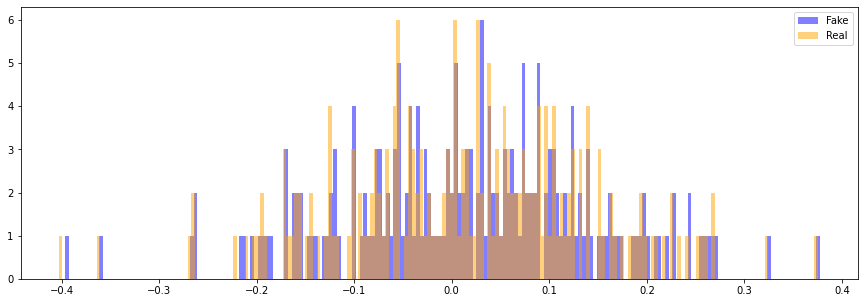


train iou_score %: 93.11


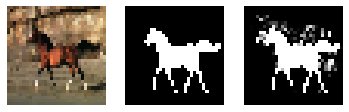

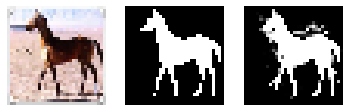

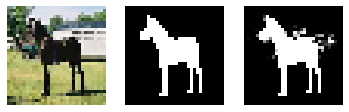

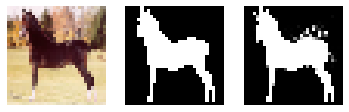

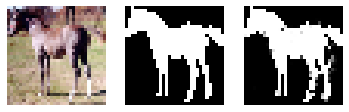

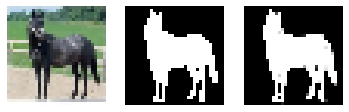

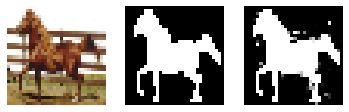

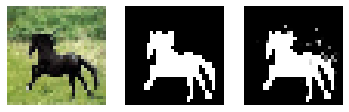

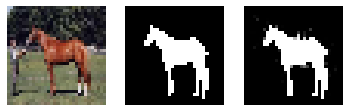

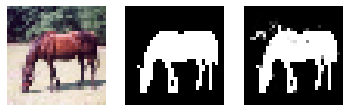


test iou_score %: 67.6


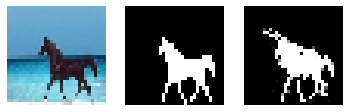

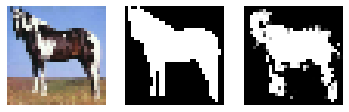

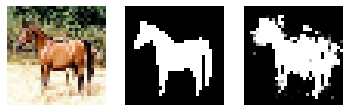

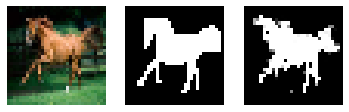

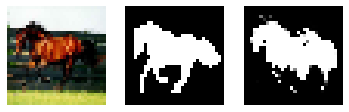

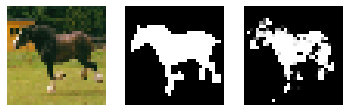

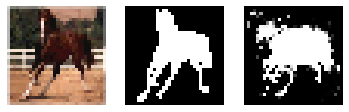

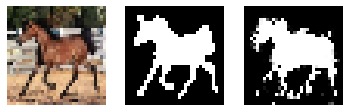

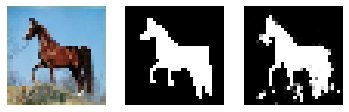

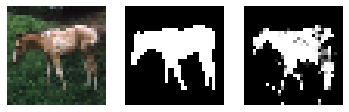


valid iou_score %: 63.39


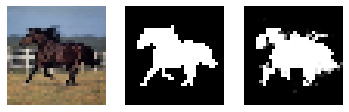

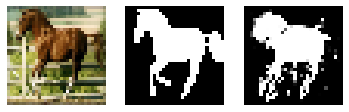

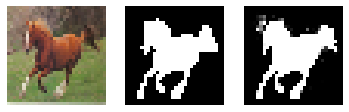

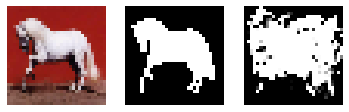

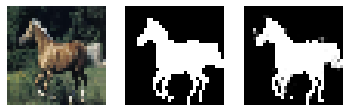

...

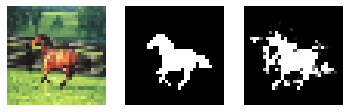

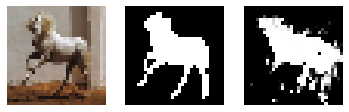

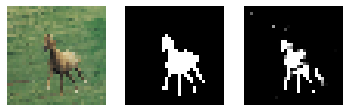

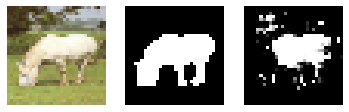

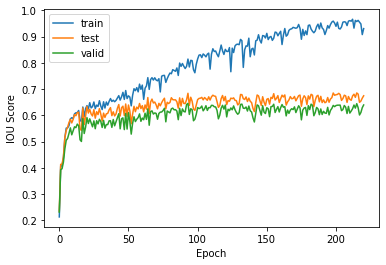

PT Gen Loss: 0.04979904741048813, Gen Loss: -0.01599987782537937, Dis Loss: 0.0017500842222943902, Adv Loss: 0.0017500842222943902

epoch: 221
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.04689890891313553, Gen Loss: -0.0014012930914759636, Dis Loss: 0.003161656903102994, Adv Loss: 0.003161656903102994

epoch: 222
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.033401742577552795, Gen Loss: -0.003931660205125809, Dis Loss: 0.0033242255449295044, Adv Loss: 0.0033242255449295044

epoch: 223
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.02925184927880764, Gen Loss: -0.016147026792168617, Dis Los

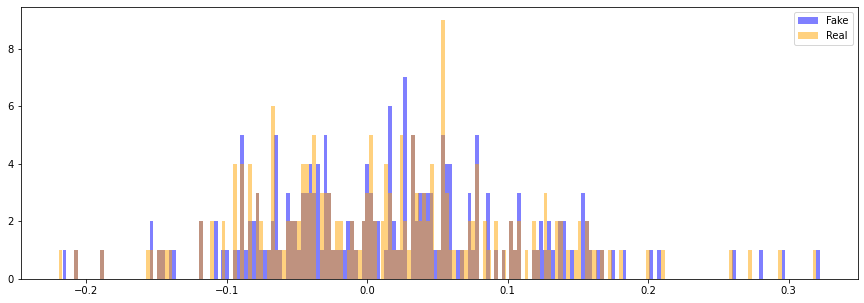


train iou_score %: 96.53


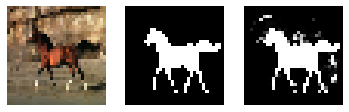

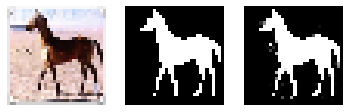

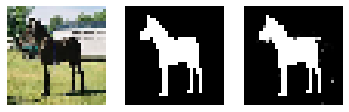

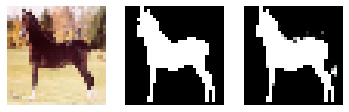

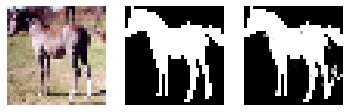

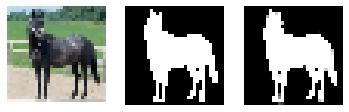

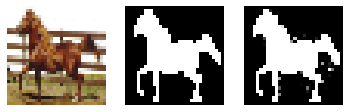

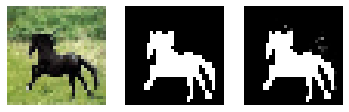

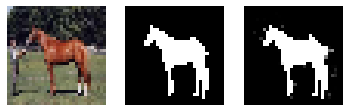

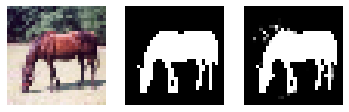


test iou_score %: 68.4


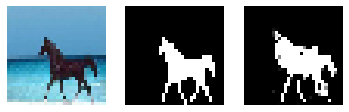

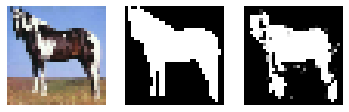

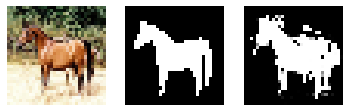

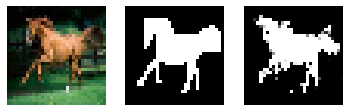

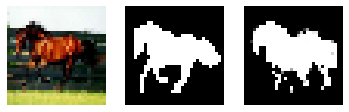

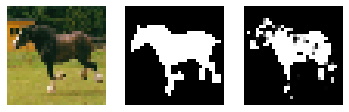

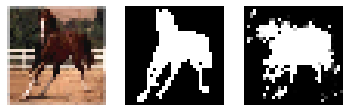

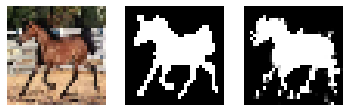

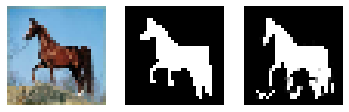

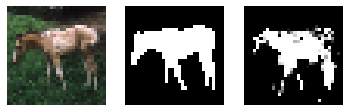


valid iou_score %: 64.28


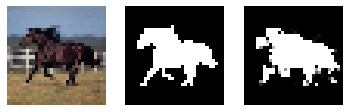

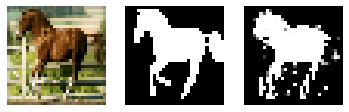

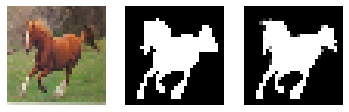

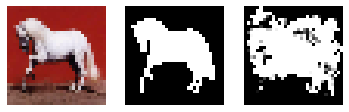

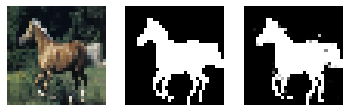

...

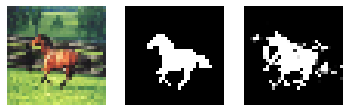

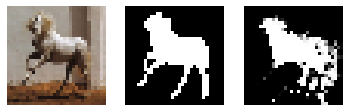

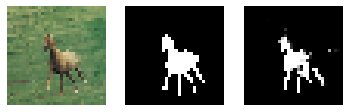

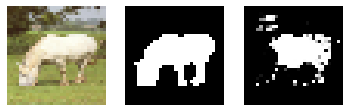

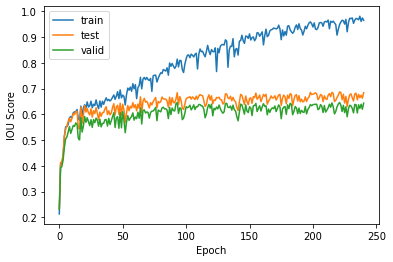

PT Gen Loss: 0.027676988393068314, Gen Loss: -0.015086588449776173, Dis Loss: 0.0015460016438737512, Adv Loss: 0.0015460016438737512

epoch: 241
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.023377669975161552, Gen Loss: -0.004804653115570545, Dis Loss: 0.0026360717602074146, Adv Loss: 0.0026360717602074146

epoch: 242
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.029596930369734764, Gen Loss: -0.005574498791247606, Dis Loss: 0.0010545032564550638, Adv Loss: 0.0010545032564550638

epoch: 243
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.0321778878569603, Gen Loss: -0.01764298789203167, Dis L

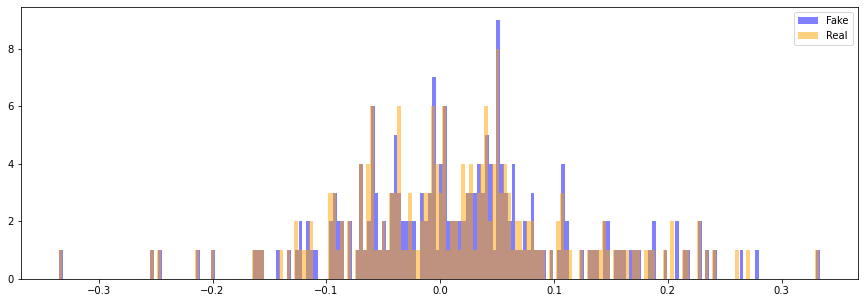


train iou_score %: 96.91


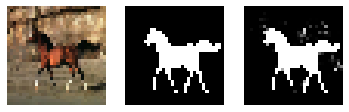

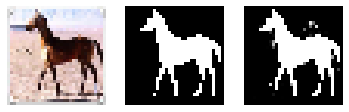

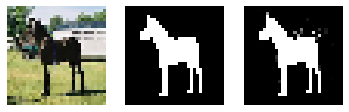

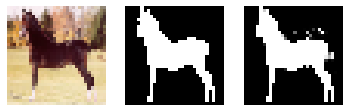

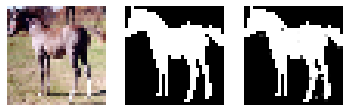

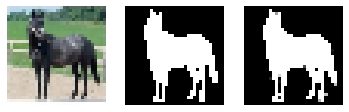

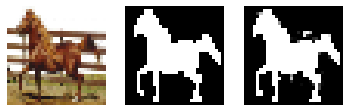

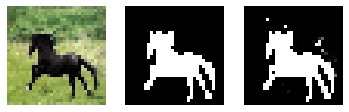

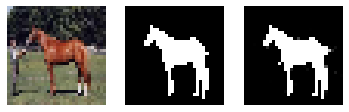

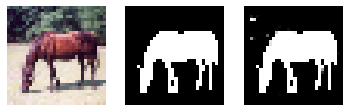


test iou_score %: 68.0


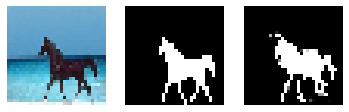

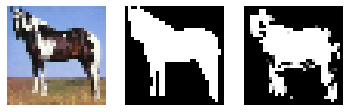

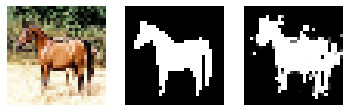

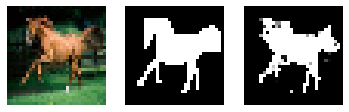

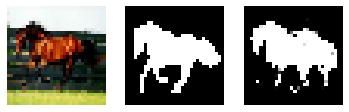

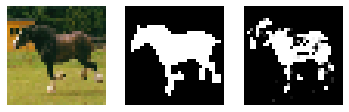

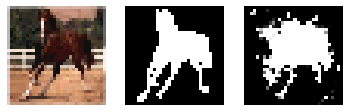

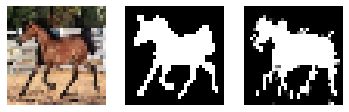

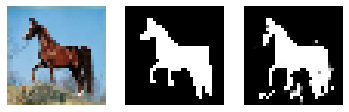

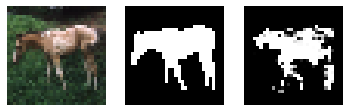


valid iou_score %: 64.4


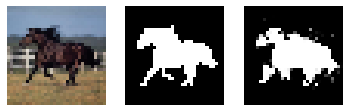

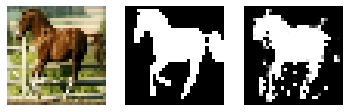

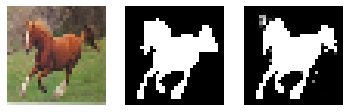

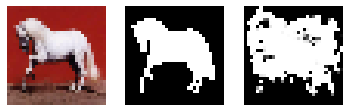

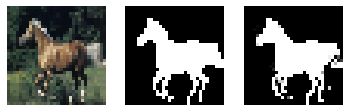

...

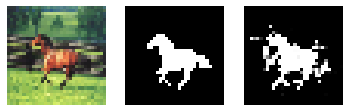

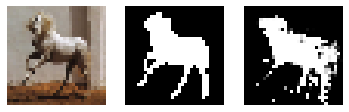

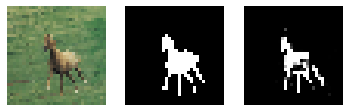

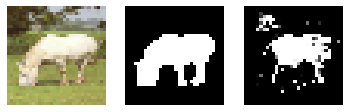

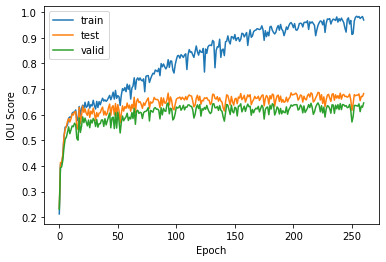

PT Gen Loss: 0.018924612551927567, Gen Loss: -0.01838093064725399, Dis Loss: 0.0011301112826913595, Adv Loss: 0.0011301112826913595

epoch: 261
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.02552149072289467, Gen Loss: -0.008756762370467186, Dis Loss: 0.0010758513817563653, Adv Loss: 0.0010758513817563653

epoch: 262
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.022576341405510902, Gen Loss: -0.006956658326089382, Dis Loss: 0.0010492197470739484, Adv Loss: 0.0010492197470739484

epoch: 263
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.019580794498324394, Gen Loss: -0.011361106298863888, Dis 

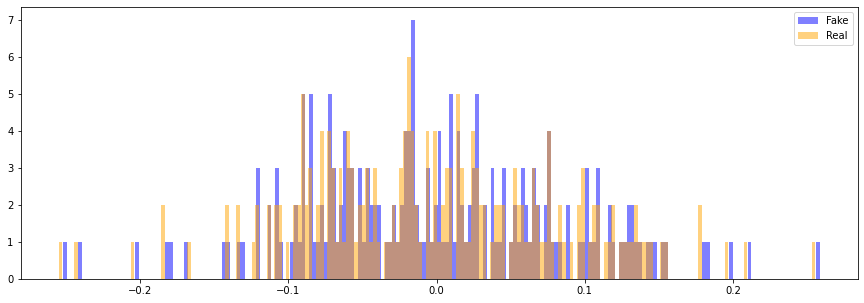


train iou_score %: 95.98


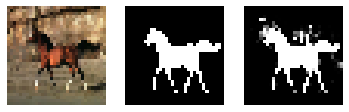

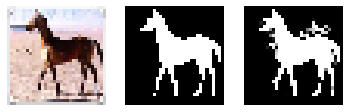

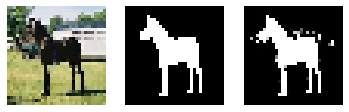

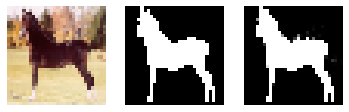

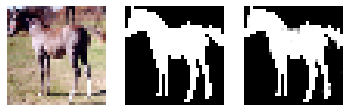

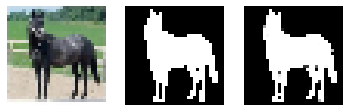

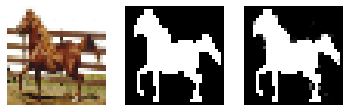

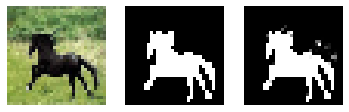

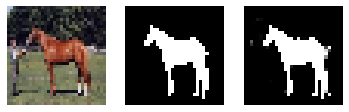

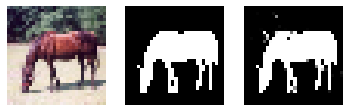


test iou_score %: 67.71


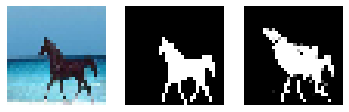

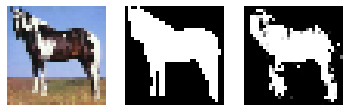

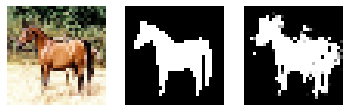

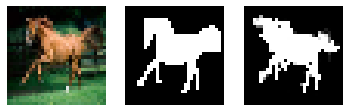

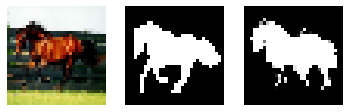

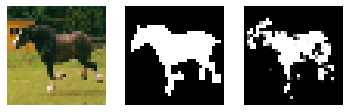

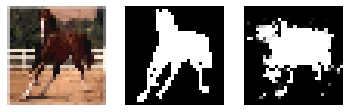

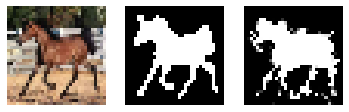

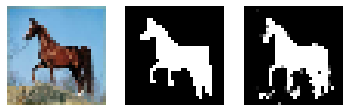

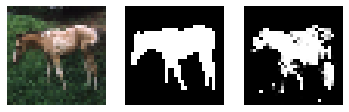


valid iou_score %: 63.84


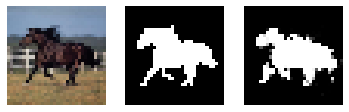

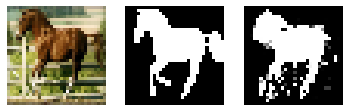

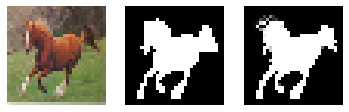

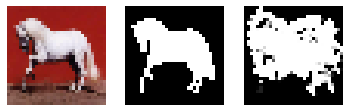

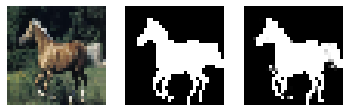

...

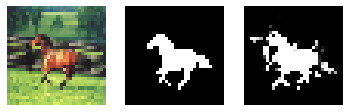

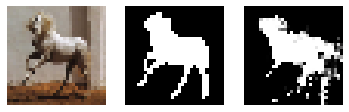

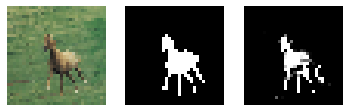

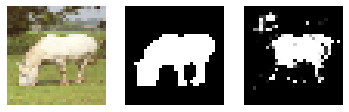

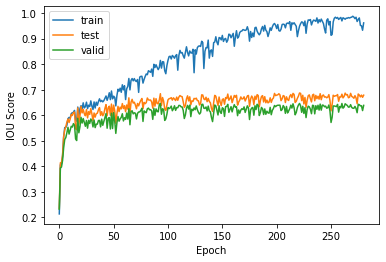

PT Gen Loss: 0.045287903398275375, Gen Loss: 0.0010906336829066277, Dis Loss: 0.002736868802458048, Adv Loss: 0.002736868802458048

epoch: 281
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.026689115911722183, Gen Loss: -0.016322162002325058, Dis Loss: 0.0011746248928830028, Adv Loss: 0.0011746248928830028

epoch: 282
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.0203053317964077, Gen Loss: -0.005383478943258524, Dis Loss: 0.000895328470505774, Adv Loss: 0.000895328470505774

epoch: 283
Executing op OptimizeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ModelDataset in device /job:localhost/replica:0/task:0/device:CPU:0
PT Gen Loss: 0.02667282149195671, Gen Loss: -0.013495716266334057, Dis Loss:

In [12]:
# general
batch_size = 10
n_epoch = 300
n_figs = 10

# disc
n_update_dis = 1
d_learning_rate = 0.0003

# pretrain gen
alpha = 0.01
pt_gen = True
pt_g_learning_rate = 0.001

# ebm gen
inf_iter = 5 #alpha
inf_rate = 2 #delta
g_learning_rate = 0.0003

##############################################################################################################

# create tf dataset generator object
N = len(xdata)
train_dataset = tf.data.Dataset.from_tensor_slices((xdata, ydata))
train_dataset = train_dataset.shuffle(buffer_size=N)
train_dataset = train_dataset.batch(batch_size=batch_size, drop_remainder=False)

# Initialize Networks
gen = Generator()
dis = Discriminator()

# Initialize Optimizer
gen_opt = tf.keras.optimizers.Adam(g_learning_rate)
gen_opt_pt = tf.keras.optimizers.Adam(pt_g_learning_rate)
dis_opt = tf.keras.optimizers.Adam(d_learning_rate)

# Initialize Metrics
adv_loss = tf.keras.metrics.Mean(name = 'Adversarial_Loss')
dis_loss = tf.keras.metrics.Mean(name = 'Discriminator_Loss')
gen_loss = tf.keras.metrics.Mean(name = 'Generator_Loss')
gen_pretrain_loss = tf.keras.metrics.Mean(name = 'Generator_Pretrain_Loss')

train(train_dataset, n_epoch, n_update_dis, inf_iter, inf_rate, pt_gen, alpha)